In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from scipy import signal
from  scipy.io import wavfile
import librosa
import librosa.display
from IPython import display
from copy import deepcopy

# the pra library
import pyroomacoustics as pra

In [2]:
# A simple wrapper class for (1-channel) audio data
# data is a 1-D NumPy array containing the data
# rate is a number expressing the samples per second
class Audio:
    def __init__(self, data, rate):
        self.data = data
        self.rate = rate
    def play(self):
        return display.Audio(self.data, rate=self.rate)
    def plot_wave(self):
        librosa.display.waveplot(self.data, sr=self.rate)
    def plot_spectrum(self):
        n_fft = int(self.rate / 20)
        D = librosa.amplitude_to_db(np.abs(librosa.stft(self.data, n_fft)), ref=np.max)
        librosa.display.specshow(D, y_axis='linear', sr=self.rate, hop_length=n_fft/4)
    @classmethod
    def fromfile(cls, fn):
        return cls(*librosa.load(fn, sr=None))

# Load Sound

In [3]:
flute = Audio.fromfile("./sounds/flute.wav")
flute.play()

In [7]:
read1 = Audio.fromfile("./sounds/read1.wav")
read1 = Audio(read1.data[:len(flute.data)], read1.rate)
read1.play()

In [8]:
background = Audio.fromfile("./sounds/background_noise.wav")
background = Audio(background.data[:len(flute.data)], background.rate)
background.play()

In [9]:
silence = Audio(np.asarray([0.0] * len(flute.data)), flute.rate)
silence.play()

/Users/mac/opt/anaconda3/envs/py3.8/lib/python3.8/site-packages/IPython/lib/display.py:174: RuntimeWarning: invalid value encountered in true_divide
  scaled = data / normalization_factor * 32767


# Beamforming

#### Noise audio is at (7,5,5)

In [31]:
def beamforming(x,y,z,sound,noise):
    '''Room Parameters and Room Creation'''
    rt60 = 0.5
    room_dim = [10, 10, 10] # meters
    e_absorption, max_order = pra.inverse_sabine(rt60, room_dim)
    # m = pra.Material(energy_absorption="panel_fabric_covered_6pcf")
    room = pra.ShoeBox(room_dim, fs=48000, materials=pra.Material(e_absorption), max_order=0) #simulate perfect situation: no reflections

    '''Sound Source Creation'''
    room.add_source([x, y, z], signal=sound)
    room.add_source([7, 5, 5], signal=noise)

    '''Mic Array Creation'''
    mic_locs = np.c_[
        [1, 4.5, 5],
#         [1, 4.6, 5],
        [1, 4.7, 5],
#         [1, 4.8, 5],
        [1, 4.9, 5],
#         [1, 5, 5],
        [1, 5.1, 5],
#         [1, 5.2, 5],
        [1, 5.3, 5],
#         [1, 5.4, 5],
        [1, 5.5, 5]
    ]

    # filter size
    Lg_t = 0.1 # filter size in seconds
    Lg = np.ceil(Lg_t*room.fs)

    # place the beamforming micarray in the room (the beamforming class is a child class of the micarray class)
    fft_len = 512
    mics = pra.Beamformer(mic_locs, room.fs, N=fft_len, Lg=Lg)
    room.add_microphone_array(mics)

    # Compute DAS (delay and sum) weights
    mics.rake_delay_and_sum_weights(room.sources[0])

    '''Simulation'''
    room.compute_rir()
    room.simulate()
    return room, mics

# SNR function
def SNR(signal,noise):
    snr = 10 * np.log10(np.mean(np.asarray(signal)**2) / np.mean(np.asarray(noise)**2))
    return snr

# Evaluation

### Four Different Positions --- Signal-to-Ration (SNR) Analysis

#### Signal and noise are at the same position (7,5,5)

Mixed-Signal SNR: -0.4914761988798101
Beamformed-Signal SNR: -0.490895509321151


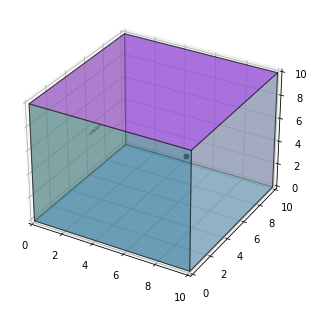

In [32]:
room, mics = beamforming(7,5,5,read1.data,background.data)
fig, ax = room.plot()

### Original_mixed ###
mix_audio = Audio(room.mic_array.signals[0, :], room.fs)
### Beamformed ###
bf_signal = mics.process()
bf_audio = Audio(bf_signal * np.linalg.norm(mix_audio.data) / np.linalg.norm(bf_signal.data), room.fs)

# construct beamformed data --> signal
room, mics = beamforming(7,5,5, read1.data, silence.data)
recv_read1 = Audio(room.mic_array.signals[0, :], room.fs)
construct_read1 = mics.process() # constructed beamformed data

# deconstructed beamformed data --> noise
room, mics = beamforming(7,5,5, silence.data, background.data)
recv_background = Audio(room.mic_array.signals[0, :], room.fs)
deconstruct_noise = mics.process() # deconstructed beamformed data

snr1 = SNR(recv_read1.data,recv_background.data)
print("Mixed-Signal SNR:", snr1)
snr2 = SNR(construct_read1,deconstruct_noise)
print("Beamformed-Signal SNR:", snr2)

#### Signal are at the front bottom left of the noise (3, 2, 2)

Mixed-Signal SNR: 2.2483364109270987
Beamformed-Signal SNR: 11.605648788098977


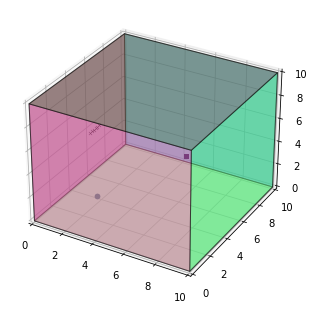

In [33]:
room, mics = beamforming(3,2,2,read1.data,background.data)
fig, ax = room.plot()

### Original_mixed ###
mix_audio = Audio(room.mic_array.signals[0, :], room.fs)
### Beamformed ###
bf_signal = mics.process()
bf_audio = Audio(bf_signal * np.linalg.norm(mix_audio.data) / np.linalg.norm(bf_signal.data), room.fs)

# construct beamformed data --> signal
room, mics = beamforming(3,2,2, read1.data, silence.data)
recv_read1 = Audio(room.mic_array.signals[0, :], room.fs)
construct_read1 = mics.process() # constructed beamformed data

# deconstructed beamformed data --> noise
room, mics = beamforming(3,2,2, silence.data, background.data)
recv_background = Audio(room.mic_array.signals[0, :], room.fs)
deconstruct_noise = mics.process() # deconstructed beamformed data

snr1 = SNR(recv_read1.data,recv_background.data)
print("Mixed-Signal SNR:", snr1)
snr2 = SNR(construct_read1,deconstruct_noise)
print("Beamformed-Signal SNR:", snr2)

#### Signal are at the front top right of the noise (5, 6, 7)

Mixed-Signal SNR: 1.6323948608210692
Beamformed-Signal SNR: 4.920211367371693


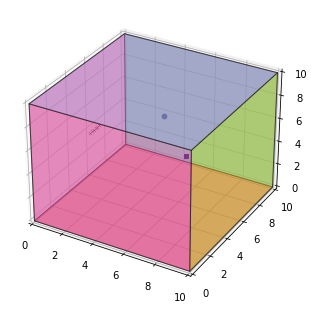

In [36]:
room, mics = beamforming(5,6,7,read1.data,background.data)
fig, ax = room.plot()

### Original_mixed ###
mix_audio = Audio(room.mic_array.signals[0, :], room.fs)
### Beamformed ###
bf_signal = mics.process()
bf_audio = Audio(bf_signal * np.linalg.norm(mix_audio.data) / np.linalg.norm(bf_signal.data), room.fs)

# construct beamformed data --> signal
room, mics = beamforming(5,6,7, read1.data, silence.data)
recv_read1 = Audio(room.mic_array.signals[0, :], room.fs)
construct_read1 = mics.process() # constructed beamformed data

# deconstructed beamformed data --> noise
room, mics = beamforming(5,6,7, silence.data, background.data)
recv_background = Audio(room.mic_array.signals[0, :], room.fs)
deconstruct_noise = mics.process() # deconstructed beamformed data

snr1 = SNR(recv_read1.data,recv_background.data)
print("Mixed-Signal SNR:", snr1)
snr2 = SNR(construct_read1,deconstruct_noise)
print("Beamformed-Signal SNR:", snr2)

#### Signal are at the back bottom right of the noise (8, 9, 2)

Mixed-Signal SNR: -3.840140960153253
Beamformed-Signal SNR: 4.099979616693522


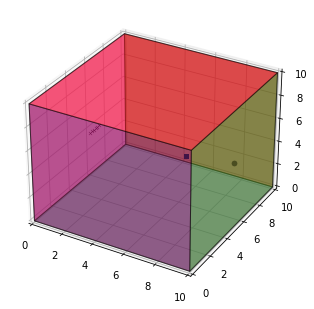

In [37]:
room, mics = beamforming(8,9,2,read1.data,background.data)
fig, ax = room.plot()

### Original_mixed ###
mix_audio = Audio(room.mic_array.signals[0, :], room.fs)
### Beamformed ###
bf_signal = mics.process()
bf_audio = Audio(bf_signal * np.linalg.norm(mix_audio.data) / np.linalg.norm(bf_signal.data), room.fs)

# construct beamformed data --> signal
room, mics = beamforming(8,9,2, read1.data, silence.data)
recv_read1 = Audio(room.mic_array.signals[0, :], room.fs)
construct_read1 = mics.process() # constructed beamformed data

# deconstructed beamformed data --> noise
room, mics = beamforming(8,9,2, silence.data, background.data)
recv_background = Audio(room.mic_array.signals[0, :], room.fs)
deconstruct_noise = mics.process() # deconstructed beamformed data

snr1 = SNR(recv_read1.data,recv_background.data)
print("Mixed-Signal SNR:", snr1)
snr2 = SNR(construct_read1,deconstruct_noise)
print("Beamformed-Signal SNR:", snr2)

#### Signal are at the back top left of the noise (9, 1, 6)

Mixed-Signal SNR: -3.785935834098842
Beamformed-Signal SNR: 1.4649565532420419


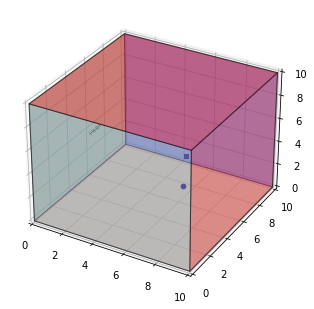

In [44]:
room, mics = beamforming(9,1,6,read1.data,background.data)
fig, ax = room.plot()

### Original_mixed ###
mix_audio = Audio(room.mic_array.signals[0, :], room.fs)
### Beamformed ###
bf_signal = mics.process()
bf_audio = Audio(bf_signal * np.linalg.norm(mix_audio.data) / np.linalg.norm(bf_signal.data), room.fs)

# construct beamformed data --> signal
room, mics = beamforming(9,1,6, read1.data, silence.data)
recv_read1 = Audio(room.mic_array.signals[0, :], room.fs)
construct_read1 = mics.process() # constructed beamformed data

# deconstructed beamformed data --> noise
room, mics = beamforming(9,1,6, silence.data, background.data)
recv_background = Audio(room.mic_array.signals[0, :], room.fs)
deconstruct_noise = mics.process() # deconstructed beamformed data

snr1 = SNR(recv_read1.data,recv_background.data)
print("Mixed-Signal SNR:", snr1)
snr2 = SNR(construct_read1,deconstruct_noise)
print("Beamformed-Signal SNR:", snr2)